# Exploratory Data Analysis of Movie Dataset

In [49]:
#Import libraries
import pandas as pd
import seaborn as sns
import numpy as np

import matplotlib
import matplotlib.pyplot as plt
plt.style.use('ggplot')
from matplotlib.pyplot import figure

%matplotlib inline
matplotlib.rcParams['figure.figsize']=(12,8) #Adjust the configuration of the plots we will create


#Read in data
df=pd.read_csv('movies.csv')

In [50]:
#Top 5 rows of data
df.head()

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
0,The Shining,R,Drama,1980,"June 13, 1980 (United States)",8.4,927000.0,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000.0,46998772.0,Warner Bros.,146.0
1,The Blue Lagoon,R,Adventure,1980,"July 2, 1980 (United States)",5.8,65000.0,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000.0,58853106.0,Columbia Pictures,104.0
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,1980,"June 20, 1980 (United States)",8.7,1200000.0,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000.0,538375067.0,Lucasfilm,124.0
3,Airplane!,PG,Comedy,1980,"July 2, 1980 (United States)",7.7,221000.0,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000.0,83453539.0,Paramount Pictures,88.0
4,Caddyshack,R,Comedy,1980,"July 25, 1980 (United States)",7.3,108000.0,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000.0,39846344.0,Orion Pictures,98.0


In [51]:
#Let see if there is any missing data

for col in df.columns:
    pct_missing = np.mean(df[col].isnull())* 100
    print('{} - {:.2f}%'.format(col, pct_missing))

name - 0.00%
rating - 1.00%
genre - 0.00%
year - 0.00%
released - 0.03%
score - 0.04%
votes - 0.04%
director - 0.00%
writer - 0.04%
star - 0.01%
country - 0.04%
budget - 28.31%
gross - 2.46%
company - 0.22%
runtime - 0.05%


In [52]:
# Drop rows with very small missing %
cols_drop_rows = ['rating', 'released', 'score', 'votes', 'writer', 'star', 'country', 'gross', 'runtime','company']
df = df.dropna(subset=cols_drop_rows)

# Fill numeric with median (good for skewed data)
df['budget'] = df['budget'].fillna(df['budget'].median())

# Double-check
print(df.isnull().sum())

name        0
rating      0
genre       0
year        0
released    0
score       0
votes       0
director    0
writer      0
star        0
country     0
budget      0
gross       0
company     0
runtime     0
dtype: int64


In [53]:
#Data types of our columns

df.dtypes

name         object
rating       object
genre        object
year          int64
released     object
score       float64
votes       float64
director     object
writer       object
star         object
country      object
budget      float64
gross       float64
company      object
runtime     float64
dtype: object

In [54]:
#Change data type

df['budget'] = df['budget'].astype('int64')

df['gross'] = df['gross'].astype('int64')

df['runtime'] = df['runtime'].astype('int64')

df['votes'] = df['runtime'].astype('int64')

In [55]:
#Display the entire DataFrame

df

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
0,The Shining,R,Drama,1980,"June 13, 1980 (United States)",8.4,146,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000,46998772,Warner Bros.,146
1,The Blue Lagoon,R,Adventure,1980,"July 2, 1980 (United States)",5.8,104,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000,58853106,Columbia Pictures,104
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,1980,"June 20, 1980 (United States)",8.7,124,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000,538375067,Lucasfilm,124
3,Airplane!,PG,Comedy,1980,"July 2, 1980 (United States)",7.7,88,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000,83453539,Paramount Pictures,88
4,Caddyshack,R,Comedy,1980,"July 25, 1980 (United States)",7.3,98,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000,39846344,Orion Pictures,98
5,Friday the 13th,R,Horror,1980,"May 9, 1980 (United States)",6.4,95,Sean S. Cunningham,Victor Miller,Betsy Palmer,United States,550000,39754601,Paramount Pictures,95
6,The Blues Brothers,R,Action,1980,"June 20, 1980 (United States)",7.9,133,John Landis,Dan Aykroyd,John Belushi,United States,27000000,115229890,Universal Pictures,133
7,Raging Bull,R,Biography,1980,"December 19, 1980 (United States)",8.2,129,Martin Scorsese,Jake LaMotta,Robert De Niro,United States,18000000,23402427,Chartoff-Winkler Productions,129
8,Superman II,PG,Action,1980,"June 19, 1981 (United States)",6.8,127,Richard Lester,Jerry Siegel,Gene Hackman,United States,54000000,108185706,Dovemead Films,127
9,The Long Riders,R,Biography,1980,"May 16, 1980 (United States)",7.0,100,Walter Hill,Bill Bryden,David Carradine,United States,10000000,15795189,United Artists,100


In [56]:
#Sort by the “gross” column from highest to lowest

df = df.sort_values(by=['gross'], inplace=False, ascending=False)

In [57]:
pd.set_option('display.max_rows',None)

In [58]:
df

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
5445,Avatar,PG-13,Action,2009,"December 18, 2009 (United States)",7.8,162,James Cameron,James Cameron,Sam Worthington,United States,237000000,2847246203,Twentieth Century Fox,162
7445,Avengers: Endgame,PG-13,Action,2019,"April 26, 2019 (United States)",8.4,181,Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,356000000,2797501328,Marvel Studios,181
3045,Titanic,PG-13,Drama,1997,"December 19, 1997 (United States)",7.8,194,James Cameron,James Cameron,Leonardo DiCaprio,United States,200000000,2201647264,Twentieth Century Fox,194
6663,Star Wars: Episode VII - The Force Awakens,PG-13,Action,2015,"December 18, 2015 (United States)",7.8,138,J.J. Abrams,Lawrence Kasdan,Daisy Ridley,United States,245000000,2069521700,Lucasfilm,138
7244,Avengers: Infinity War,PG-13,Action,2018,"April 27, 2018 (United States)",8.4,149,Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,321000000,2048359754,Marvel Studios,149
7480,The Lion King,PG,Animation,2019,"July 19, 2019 (United States)",6.9,118,Jon Favreau,Jeff Nathanson,Donald Glover,United States,260000000,1670727580,Walt Disney Pictures,118
6653,Jurassic World,PG-13,Action,2015,"June 12, 2015 (United States)",7.0,124,Colin Trevorrow,Rick Jaffa,Chris Pratt,United States,150000000,1670516444,Universal Pictures,124
6043,The Avengers,PG-13,Action,2012,"May 4, 2012 (United States)",8.0,143,Joss Whedon,Joss Whedon,Robert Downey Jr.,United States,220000000,1518815515,Marvel Studios,143
6646,Furious 7,PG-13,Action,2015,"April 3, 2015 (United States)",7.1,137,James Wan,Chris Morgan,Vin Diesel,United States,190000000,1515341399,Universal Pictures,137
7494,Frozen II,PG,Animation,2019,"November 22, 2019 (United States)",6.8,103,Chris Buck,Jennifer Lee,Kristen Bell,United States,150000000,1450026933,Walt Disney Animation Studios,103


In [59]:
# Budget high correlation
# Company high correlation

### Scatter Plot with Budget vs Gross

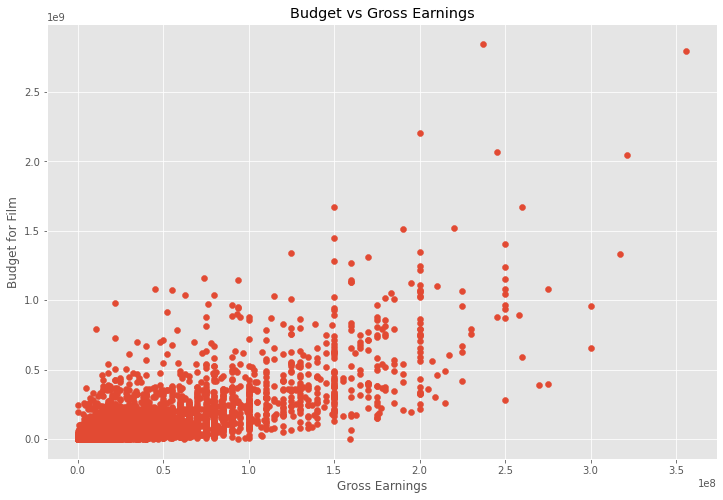

In [60]:
plt.scatter(x=df['budget'], y=df['gross'])
plt.title('Budget vs Gross Earnings')
plt.xlabel('Gross Earnings')
plt.ylabel('Budget for Film')
plt.show()

In [61]:
df.head()

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
5445,Avatar,PG-13,Action,2009,"December 18, 2009 (United States)",7.8,162,James Cameron,James Cameron,Sam Worthington,United States,237000000,2847246203,Twentieth Century Fox,162
7445,Avengers: Endgame,PG-13,Action,2019,"April 26, 2019 (United States)",8.4,181,Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,356000000,2797501328,Marvel Studios,181
3045,Titanic,PG-13,Drama,1997,"December 19, 1997 (United States)",7.8,194,James Cameron,James Cameron,Leonardo DiCaprio,United States,200000000,2201647264,Twentieth Century Fox,194
6663,Star Wars: Episode VII - The Force Awakens,PG-13,Action,2015,"December 18, 2015 (United States)",7.8,138,J.J. Abrams,Lawrence Kasdan,Daisy Ridley,United States,245000000,2069521700,Lucasfilm,138
7244,Avengers: Infinity War,PG-13,Action,2018,"April 27, 2018 (United States)",8.4,149,Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,321000000,2048359754,Marvel Studios,149


Text(0, 0.5, 'Gross Revenue (USD)')

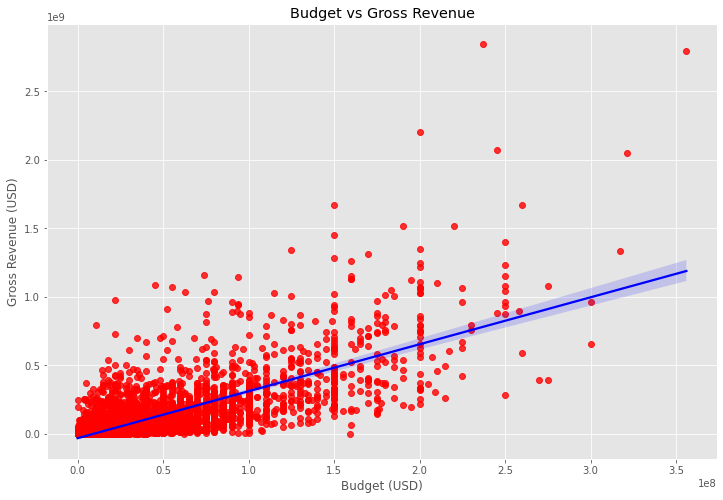

In [63]:
#Plot budget vs gross using seaborn
sns.regplot(x='budget', y='gross', data=df, scatter_kws={"color":"red"}, line_kws={"color":"blue"})

plt.title("Budget vs Gross Revenue")
plt.xlabel("Budget (USD)")
plt.ylabel("Gross Revenue (USD)")

In [66]:
df.corr(method='pearson') #pearson, kendall, spearman

,year,score,votes,budget,gross,runtime
year,1.000000,0.093951,0.114237,0.290399,0.258826,0.114237
score,0.093951,1.000000,0.397226,0.059271,0.188071,0.397226
votes,0.114237,0.397226,1.000000,0.273522,0.245117,1.000000
budget,0.290399,0.059271,0.273522,1.000000,0.744394,0.273522
gross,0.258826,0.188071,0.245117,0.744394,1.000000,0.245117
runtime,0.114237,0.397226,1.000000,0.273522,0.245117,1.000000


### High correlation between budget and gross

## Correlation Heatmap

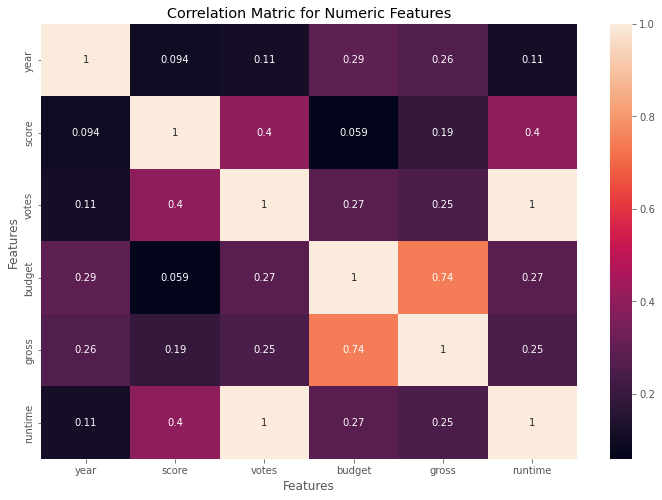

In [69]:
correlation_matrix = df.corr(method='pearson')

sns.heatmap(correlation_matrix, annot=True)
plt.title("Correlation Matric for Numeric Features")
plt.xlabel("Features")
plt.ylabel("Features")
plt.show()

In [71]:
#Creating df_numerized, a version of the dataset where all features are numeric
df_numerized = df
for col_name in df_numerized.columns:
    if(df_numerized[col_name].dtype == 'object'):
        df_numerized[col_name] = df_numerized[col_name].astype('category')
        df_numerized[col_name] = df_numerized[col_name].cat.codes
        
df_numerized

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
5445,515,5,0,2009,678,7.8,162,1107,1705,2198,53,237000000,2847246203,2115,162
7445,517,5,0,2019,176,8.4,181,160,708,2107,53,356000000,2797501328,1508,181
3045,6668,5,6,1997,686,7.8,194,1107,1705,1502,53,200000000,2201647264,2115,194
6663,4958,5,0,2015,680,7.8,138,1077,2448,494,53,245000000,2069521700,1446,138
7244,518,5,0,2018,185,8.4,149,160,708,2107,53,321000000,2048359754,1508,149
7480,5984,4,2,2019,1441,6.9,118,1400,1840,633,53,260000000,1670727580,2176,118
6653,2869,5,0,2015,1653,7.0,124,497,3429,412,53,150000000,1670516444,2142,124
6043,5303,5,0,2012,2398,8.0,143,1461,2224,2107,53,220000000,1518815515,1508,143
6646,2069,5,0,2015,212,7.1,137,1139,672,2564,53,190000000,1515341399,2142,137
7494,2055,4,2,2019,2591,6.8,103,419,1871,1439,53,150000000,1450026933,2175,103


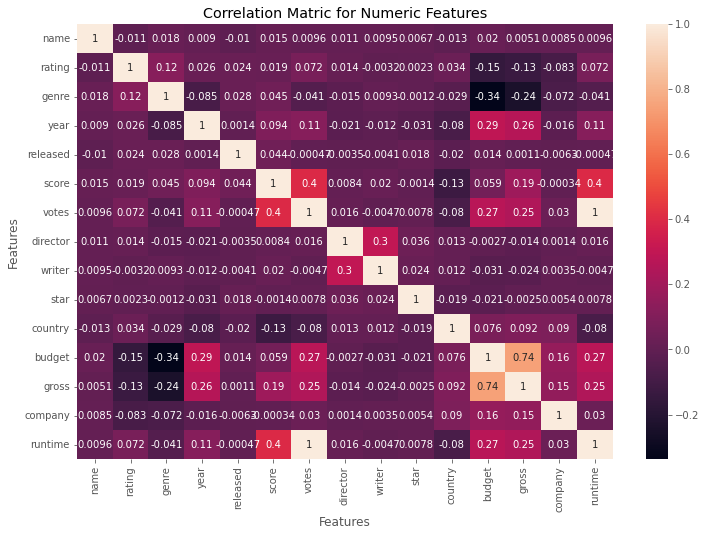

In [72]:
correlation_matrix = df.corr(method='pearson')

sns.heatmap(correlation_matrix, annot=True)
plt.title("Correlation Matric for Numeric Features")
plt.xlabel("Features")
plt.ylabel("Features")
plt.show()

In [74]:
df_numerized.corr()

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
name,1.000000,-0.010815,0.018363,0.008987,-0.010012,0.014970,0.009563,0.010575,0.009451,0.006731,-0.012544,0.019963,0.005135,0.008529,0.009563
rating,-0.010815,1.000000,0.118600,0.025950,0.024188,0.018596,0.072340,0.013653,-0.003234,0.002255,0.033607,-0.149646,-0.131786,-0.083083,0.072340
genre,0.018363,0.118600,1.000000,-0.084892,0.027639,0.045478,-0.040939,-0.015227,0.009340,-0.001158,-0.029208,-0.336743,-0.242597,-0.071590,-0.040939
year,0.008987,0.025950,-0.084892,1.000000,0.001440,0.093951,0.114237,-0.021394,-0.011853,-0.031476,-0.080122,0.290399,0.258826,-0.015880,0.114237
released,-0.010012,0.024188,0.027639,0.001440,1.000000,0.044469,-0.000472,-0.003460,-0.004121,0.017597,-0.020491,0.014438,0.001084,-0.006299,-0.000472
score,0.014970,0.018596,0.045478,0.093951,0.044469,1.000000,0.397226,0.008358,0.019710,-0.001386,-0.126497,0.059271,0.188071,-0.000342,0.397226
votes,0.009563,0.072340,-0.040939,0.114237,-0.000472,0.397226,1.000000,0.015713,-0.004668,0.007827,-0.079525,0.273522,0.245117,0.030234,1.000000
director,0.010575,0.013653,-0.015227,-0.021394,-0.003460,0.008358,0.015713,1.000000,0.297126,0.036188,0.012726,-0.002718,-0.014296,0.001379,0.015713
writer,0.009451,-0.003234,0.009340,-0.011853,-0.004121,0.019710,-0.004668,0.297126,1.000000,0.024161,0.012415,-0.031321,-0.024021,0.003462,-0.004668
star,0.006731,0.002255,-0.001158,-0.031476,0.017597,-0.001386,0.007827,0.036188,0.024161,1.000000,-0.018838,-0.020620,-0.002451,0.005417,0.007827


In [75]:
correlation_mat = df_numerized.corr()
corr_pairs = correlation_mat.unstack()
corr_pairs

name      name        1.000000
          rating     -0.010815
          genre       0.018363
          year        0.008987
          released   -0.010012
          score       0.014970
          votes       0.009563
          director    0.010575
          writer      0.009451
          star        0.006731
          country    -0.012544
          budget      0.019963
          gross       0.005135
          company     0.008529
          runtime     0.009563
rating    name       -0.010815
          rating      1.000000
          genre       0.118600
          year        0.025950
          released    0.024188
          score       0.018596
          votes       0.072340
          director    0.013653
          writer     -0.003234
          star        0.002255
          country     0.033607
          budget     -0.149646
          gross      -0.131786
          company    -0.083083
          runtime     0.072340
genre     name        0.018363
          rating      0.118600
        

In [76]:
sorted_pairs = corr_pairs.sort_values()
sorted_pairs

budget    genre      -0.336743
genre     budget     -0.336743
          gross      -0.242597
gross     genre      -0.242597
rating    budget     -0.149646
budget    rating     -0.149646
gross     rating     -0.131786
rating    gross      -0.131786
score     country    -0.126497
country   score      -0.126497
genre     year       -0.084892
year      genre      -0.084892
rating    company    -0.083083
company   rating     -0.083083
country   year       -0.080122
year      country    -0.080122
runtime   country    -0.079525
country   runtime    -0.079525
votes     country    -0.079525
country   votes      -0.079525
genre     company    -0.071590
company   genre      -0.071590
runtime   genre      -0.040939
genre     votes      -0.040939
votes     genre      -0.040939
genre     runtime    -0.040939
star      year       -0.031476
year      star       -0.031476
budget    writer     -0.031321
writer    budget     -0.031321
genre     country    -0.029208
country   genre      -0.029208
writer  

In [77]:
high_corr = sorted_pairs[(sorted_pairs) > 0.5]
high_corr

budget    gross       0.744394
gross     budget      0.744394
name      name        1.000000
runtime   votes       1.000000
director  director    1.000000
gross     gross       1.000000
budget    budget      1.000000
country   country     1.000000
star      star        1.000000
writer    writer      1.000000
votes     runtime     1.000000
          votes       1.000000
score     score       1.000000
released  released    1.000000
year      year        1.000000
genre     genre       1.000000
rating    rating      1.000000
company   company     1.000000
runtime   runtime     1.000000
dtype: float64